[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/jamescalam/applied-ml-minicourse/blob/main/code/07-images-in-gcp.ipynb)

# 07: Adding Images to GCP Cloud Storage

Our app requires a location for image storage, for that we'll use *Cloud Storage*. We've already setup our Cloud Storage bucket so we can jump right into uploading and downloading images with the Python SDK.

## Data Preparation

We first need a set of images to upload, we can download a small number of images from the [`jamescalam/image-text-demo`](https://huggingface.co/datasets/jamescalam/image-text-demo) dataset via Hugging Face *Datasets*.

In [1]:
from datasets import load_dataset

images = load_dataset(
    'jamescalam/image-text-demo',
    split='train'
)
images

Using custom data configuration default
Reusing dataset image_set (/Users/jamesbriggs/.cache/huggingface/datasets/jamescalam___image_set/default/0.0.0/83e33802f1af183872ab59b5bf8b7ae25968f4e294f8529fdae035f54b9a5abc)


Dataset({
    features: ['text', 'image'],
    num_rows: 21
})

Each row contains a text description of an image:

In [2]:
images[0]

{'text': 'aerial shot of futuristic city with large motorway',
 'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=6000x3376 at 0x106EF94C0>}

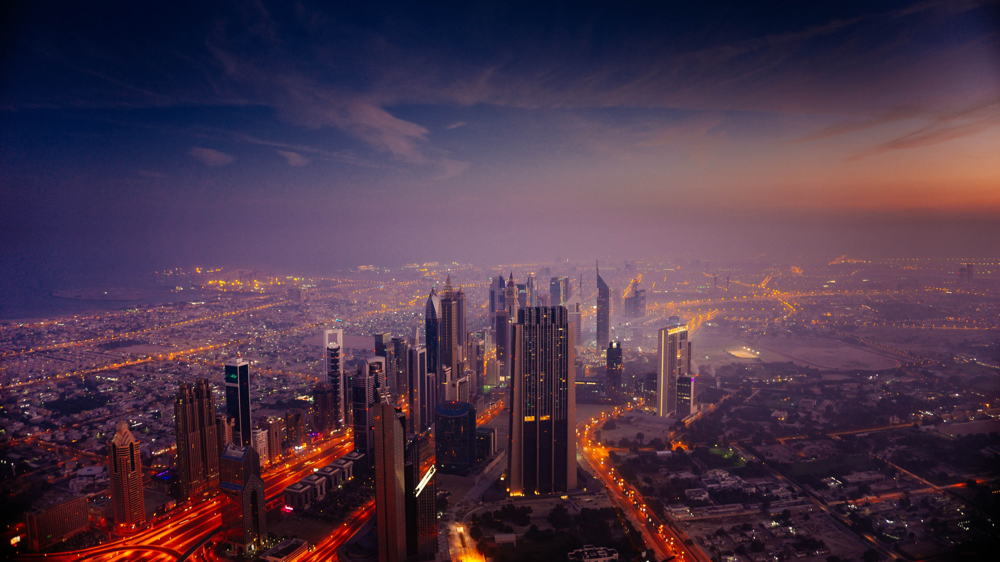

In [4]:
images[0]['image']

With the dataset downloaded we can move on to uploading the images to our Google Cloud bucket.

## Python SDK

Getting started we need to initialize our connection. To do this we need the Cloud Storage credentials JSON file and add the path to our environment variables like so:

In [ ]:
import os

# set credentials
os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = 'cloud-storage.json'

Then connect to our `diffusion` bucket:

In [ ]:
from google.cloud import storage

# connect to bucket (we named it 'diffusion')
storage_client = storage.Client()
bucket = storage_client.get_bucket('diffusion')

We're ready to begin adding our images.

### Uploading Data

We'll try uploading the first image. We assign it a unique ID via the `uuid` library:

In [1]:
import uuid

_id = str(uuid.uuid4())
_id

'b93d76e1-4a87-4f6b-8cf3-f52df238b1fd'

We then save the image to file:

In [ ]:
images[0]['image'].save(f"{_id}.png")

And upload to Cloud Storage using the same filename:

In [ ]:
blob = bucket.blob(f"{_id}.png")
blob.upload_from_filename(f"{_id}.png")

If we head over to our Cloud Storage console we should be able to find the image.

TK screenshot

With the image uploaded let's see how we can download and view it.

### Downloading Data

To download an image we need the ID filename that we saved it with:

In [ ]:
blob = bucket.blob(f"{_id}.png").download_as_string()

We can either save this to file and load it again, or just store it as an 'in-memory file' using the `io` library.

In [ ]:
import io

blob_bytes = io.BytesIO(blob)

Then we open the *in-memory file* as a `PIL` `Image` object.

In [ ]:
from PIL import Image

im = Image.open(blob_bytes)
# and view
im.show()

That is how we upload/download images with Cloud Storage. In the next chapter we'll see how to apply this in conjunction with our vector database to complete our data storage component.